<a href="https://colab.research.google.com/github/Kim-TaeKyoung/a/blob/main/1_1_YOLOv5_Train.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#1. 환경세팅(의존성 패키지 설치)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# 필요 패키지 설정
import os
import sys
import random
import json
import time
import datetime
import yaml
import glob
from IPython.display import Image, clear_output, display
from IPython.core.magic import register_line_cell_magic

!cd /content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5 && pip install -qr requirements.txt

sys.path.append("/content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/");
from utils.plots import plot_results
import torch
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))
%cd /content

     |████████████████████████████████| 596 kB 12.9 MB/s 
Setup complete. Using torch 1.9.0+cu111 _CudaDeviceProperties(name='Tesla V100-SXM2-16GB', major=7, minor=0, total_memory=16160MB, multi_processor_count=80)
/content


In [ ]:
# 데이터셋 압축해제
# os.environ['DATASET_PATH'] = '/content/drive/MyDrive/Colab/AI_ChampionShip/dataset/od_labeling/2021_10_27_yolo_16k.zip'

# path = '../content/obj_train_data'
# os.mkdir(path)

# !unzip $DATASET_PATH -d ../content/obj_train_data
# !curl -L "https://app.roboflow.com/ds/kUUbKRYW6H?key=59ROPg5fkJ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip # 5.4K
!curl -L "https://app.roboflow.com/ds/D6aR9dvHZK?key=Uqqn8lqPW8" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip # 10월 30일 데이터셋 7.8k

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
 extracting: train/labels/-420-1700---fire_jpg.rf.1925c60917fee54fa8e4bfe0dcaa29dc.txt  
 extracting: train/labels/-420-1701---fire_jpg.rf.1e16ba4365d9f9feff5a798f862fdec2.txt  
 extracting: train/labels/-420-1702---fire_jpg.rf.506c3e1a1d0438b0f5ad24239c447bee.txt  
 extracting: train/labels/-420-1703---fire_jpg.rf.16d4c6a6cce026ce7dcaadc1ca4d88cb.txt  
 extracting: train/labels/-420-1726---fire_jpg.rf.ed80ff18ea72fb39117bdbdf693fe3cd.txt  
 extracting: train/labels/-420-1727---fire_jpg.rf.063416761ad9b4bed20ba387ef9e4e25.txt  
 extracting: train/labels/-420-1728---fire_jpg.rf.d370f50d8a0cbb18f3a7ad6bafdac63a.txt  
 extracting: train/labels/-420-1729---fire_jpg.rf.4d26da79c2d9f6b3209a88515f871b4c.txt  
 extracting: train/labels/-420-1730---fire_jpg.rf.a323a3fa9bb24b0fe07392ee0dc3a038.txt  
 extracting: train/labels/-420-1731---fire_jpg.rf.b224925d86e4c44ed77738fa3f810e92.txt  
 extracting: train/labels/-420-1732---fire_jpg.rf.25daa2839747af5f46ccb9e6

#2. 모델 구성 및 아키텍처 정의


In [ ]:
# 데이터셋에서 레이블 불러옴
with open("../content/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

# 모델 구조 확인
%cat /content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/models/yolov5x.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 2  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],

In [ ]:
# 모델 구조 설정을 위한 Colab Magic 설정
@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
# 모델 구조 설정 파일 저장
%%writetemplate /content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/models/custom_yolov5x.yaml
# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 2  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]


# 3. 훈련
파라미터

*   img = define input image size
*   batch: determine batch size
*   epochs: define the number of training epochs. (Note: often, 3000+ are common here!)
*   data: set the path to our yaml file
*   cfg: specify our model configuration
*   weights: specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive folder)
*   name: result names
*   nosave: only save the final checkpoint
*   cache: cache images for faster training

















In [ ]:
# 학습 시작
# Optimizer로 SGD 사용, 이미지 크기는 416x416으로 통일, 배치 사이즈는 32, epochs는 500으로, learning_rate는 0.01 시작
# 매 epochs 마다 learning rate는 (1 - x / (500 - 1)) * (1.0 - 0.2) + 0.2] 로 감소함
today = datetime.datetime.fromtimestamp(time.time()).strftime("%Y%m%d-%H%M%S") + "_"
additional_comment = "7.8k"
ENVING = today + additional_comment
os.environ['NAME'] = ENVING
print('Training name under', ENVING)

!python /content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/train.py --img 416 --batch 32 --epochs 500 --data '../content/data.yaml' --cfg /content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/models/custom_yolov5x.yaml --weights '' --name $NAME  --cache

Training name under 20211029-170019_7.8k
train: weights=, cfg=/content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/models/custom_yolov5x.yaml, data=../content/data.yaml, hyp=drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/data/hyps/hyp.scratch.yaml, epochs=500, batch_size=32, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, entity=None, project=drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/runs/train, name=20211029-170019_7.8k, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=100
github: skipping check (not a git repository), for updates see https://github.com/ultralytics/yolov5
YOLOv5 🚀 2021-9-29 torch 1.9.0+cu111 CUDA:0 (Tesla V100-SXM2-16GB, 16160.5MB)

hyperparameters: lr0=0.01, lrf=0.2, momen

In [ ]:
# 학습 결과 텐서보드
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/runs/train

<IPython.core.display.Javascript object>

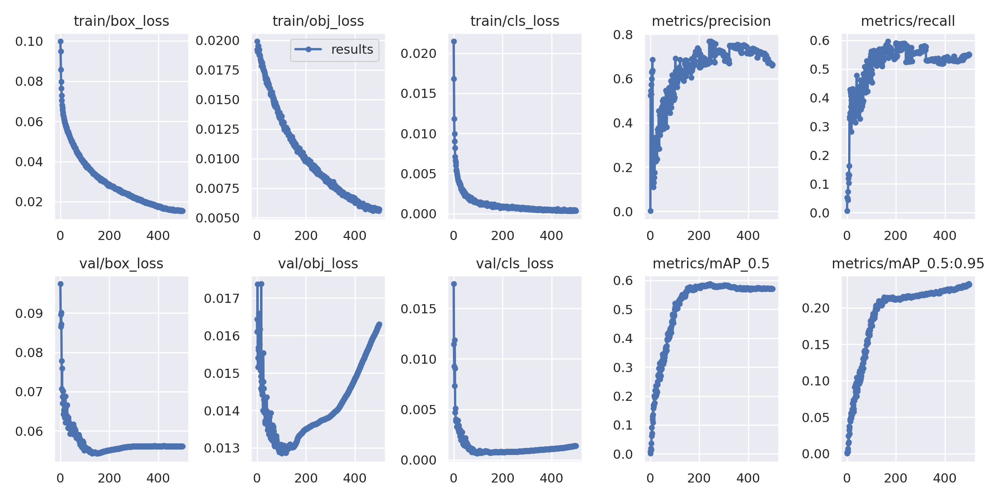

In [ ]:
# 학습 그래프
ENVING = '20211020-015309_6k'
Image(filename='/content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/runs/train/' + ENVING + '/results.png', width=1000)


# 평가

In [ ]:
os.environ['WEIGHTS_PATH'] = "/content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/runs/train/" + ENVING + "/weights/best.pt"

!python /content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/detect.py --weights $WEIGHTS_PATH --img 416 --conf 0.1 --source ../content/obj_train_data/valid/images

detect: weights=['/content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/runs/train/20211020-015309_6k/weights/best.pt'], source=../content/obj_train_data/valid/images, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=drive/.shortcut-targets-by-id/1FOaYE4TKVMcOyh2bFD0bY-QEI5Gufq5t/AI_ChampionShip/YOLOv5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 2021-9-29 torch 1.9.0+cu111 CUDA:0 (Tesla V100-SXM2-16GB, 16160.5MB)

Fusing layers... 
Model Summary: 476 layers, 87205423 parameters, 0 gradients, 217.1 GFLOPs
image 1/497 /content/obj_train_data/valid/images/-10-108---fire_jpg.rf.0dea2fef0a0741a9754319464aa6603c.jpg: 256x416 5 fires, Done. (0.030s)
image 2/497 /content/obj_train_data/valid/images/-10-23---fire_jpg.rf.82b5b94b54945c46b936

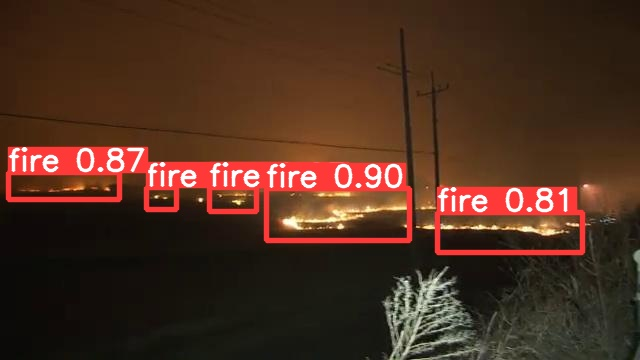

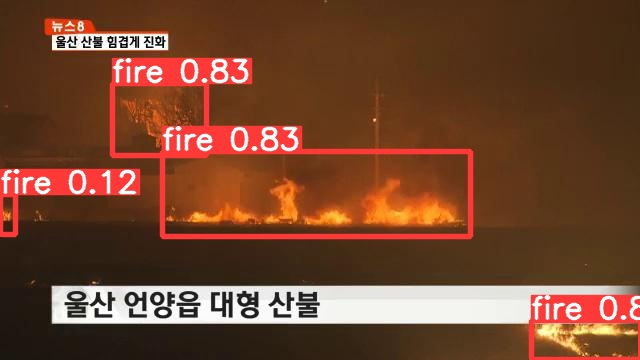

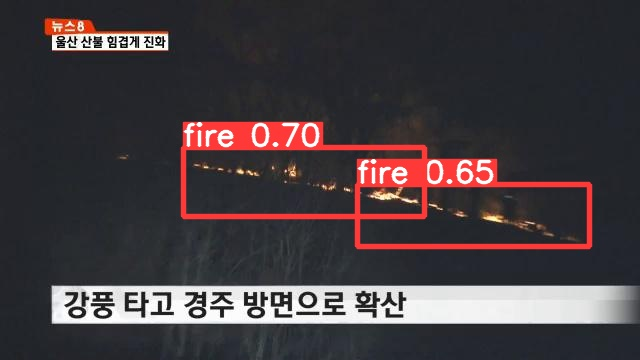

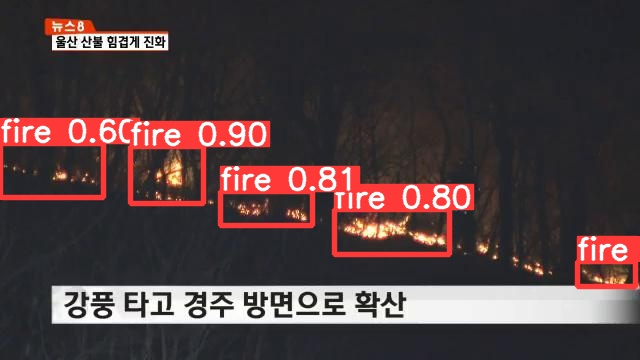

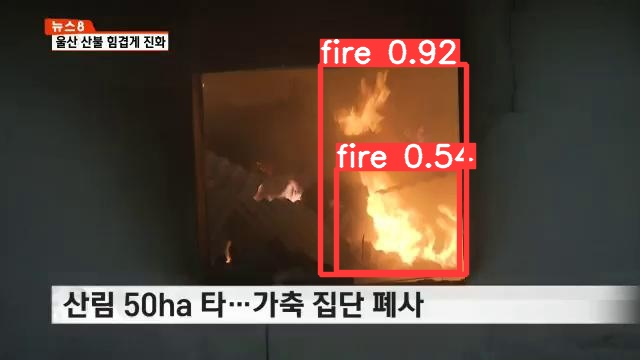

...

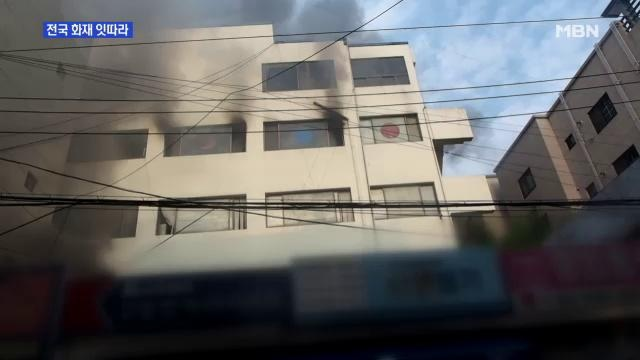

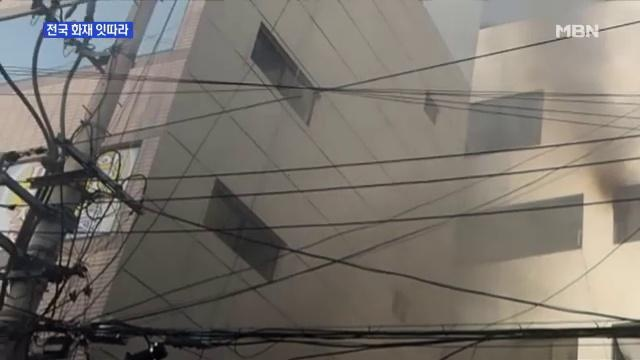

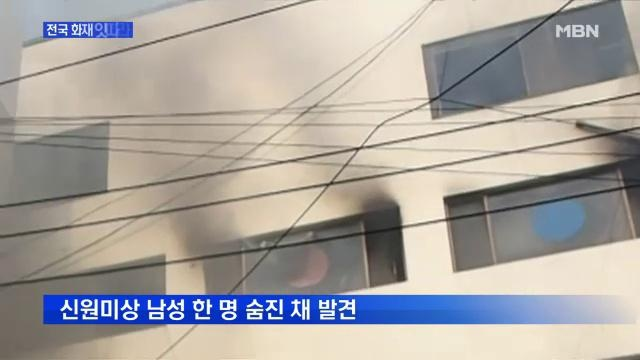

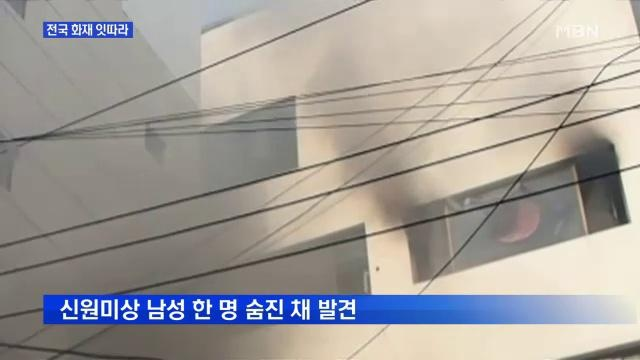

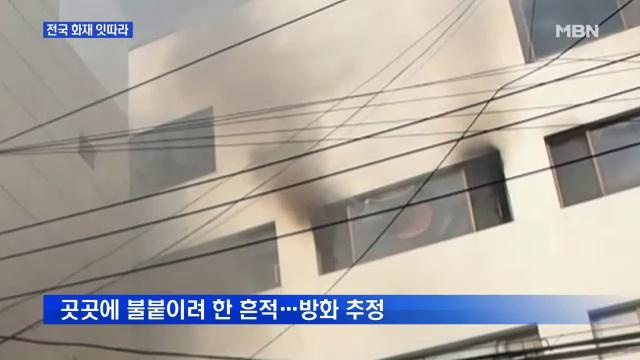

In [ ]:
# Validation 결과 이미지 확인
for imageName in glob.glob('/content/drive/MyDrive/Colab/AI_ChampionShip/YOLOv5/runs/detect/exp17/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")